In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import AveragePooling2D, Dropout, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint
from google.colab import files
import matplotlib.pyplot as plt
from keras.applications import VGG19
from keras.layers import Conv2D, MaxPooling2D,Dense,Activation,Dropout,Flatten,BatchNormalization
from keras.layers import Dense,Dropout,Input,MaxPooling2D,MaxPool2D,Conv2D,Flatten
from keras.models import Sequential
from keras.losses import categorical_crossentropy
from keras.optimizers import Adam,SGD

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


# **Preprocess and analysis**

In [ ]:
IMAGE_SIZE = 331
BATCH_SIZE = 64

datagen = tf.keras.preprocessing.image.ImageDataGenerator()

# Train generator for train folder
train_generator = datagen.flow_from_directory(
    "/content/drive/MyDrive/Car_Brand_Logos/Train",
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    class_mode="categorical",
    color_mode="rgb",
    batch_size=BATCH_SIZE)

# Test generator for test folder
test_generator = datagen.flow_from_directory(
    "/content/drive/MyDrive/Car_Brand_Logos/Test",
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    class_mode="categorical",
    color_mode="rgb",
    batch_size=BATCH_SIZE)

Found 2513 images belonging to 8 classes.
Found 400 images belonging to 8 classes.


Creating model
**We are creating a CNN model for 331x331 RGB pictures .

In [ ]:
vgg = VGG19(include_top= False, weights = "imagenet", input_shape=( IMAGE_SIZE,IMAGE_SIZE, 3))
vgg_layer_list = vgg.layers

model = Sequential ()

for layer in vgg_layer_list:
    model.add(layer)

for layer in model.layers:
    layer.trainable = False


model.add(Flatten())
model.add(Dense(1024))
model.add(Activation('relu'))
model.add(Dropout(0.2))

model.add(Dense(512))
model.add(Activation('relu'))
model.add(Dropout(0.2))

model.add(Dense(8))
model.add(Activation('softmax'))
model.summary()

opt = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999)

model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=["accuracy"])

model.summary()

80134624/80134624 [==============================] - 5s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 331, 331, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 331, 331, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 165, 165, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 165, 165, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 165, 165, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 82, 82, 128)       0         
                                                         

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 331, 331, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 331, 331, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 165, 165, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 165, 165, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 165, 165, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 82, 82, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 82, 82, 256)       2

# **Training the Keras Model**

In [ ]:
epochs = 10

checkpoint = ModelCheckpoint('model.{epoch:02d}-{val_loss:.2f}.h5',
                             monitor='val_loss',
                             verbose=0,
                             save_best_only=True,
                             mode='auto')

history = model.fit(train_generator,
                    steps_per_epoch=len(train_generator),
                    epochs=epochs,
                    validation_data=test_generator,
                    validation_steps=len(test_generator),
                    callbacks=[checkpoint])

Epoch 1/10
40/40 [==============================] - ETA: 0s - loss: 31.3785 - accuracy: 0.5189 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


40/40 [==============================] - 865s 21s/step - loss: 31.3785 - accuracy: 0.5189 - val_loss: 5.7654 - val_accuracy: 0.7225
Epoch 2/10
40/40 [==============================] - 41s 1s/step - loss: 2.7169 - accuracy: 0.8269 - val_loss: 3.7029 - val_accuracy: 0.7600
Epoch 3/10
40/40 [==============================] - 39s 962ms/step - loss: 1.3698 - accuracy: 0.8874 - val_loss: 5.2791 - val_accuracy: 0.7475
Epoch 4/10
40/40 [==============================] - 42s 1s/step - loss: 1.3989 - accuracy: 0.9041 - val_loss: 5.6939 - val_accuracy: 0.7675
Epoch 5/10
40/40 [==============================] - 38s 948ms/step - loss: 1.2201 - accuracy: 0.9359 - val_loss: 5.6587 - val_accuracy: 0.7525
Epoch 6/10
40/40 [==============================] - 38s 945ms/step - loss: 1.3502 - accuracy: 0.9351 - val_loss: 6.4743 - val_accuracy: 0.7725
Epoch 7/10
40/40 [==============================] - 38s 939ms/step - loss: 1.1338 - accuracy: 0.9439 - val_loss: 6.5478 - val_accuracy: 0.7700
Epoch 8/10
40/40

In [ ]:
epochs = 10

checkpoint = ModelCheckpoint('model.{epoch:02d}-{val_loss:.2f}.h5',
                             monitor='val_loss',
                             verbose=0,
                             save_best_only=True,
                             mode='auto')

history2 = model.fit(train_generator,
                    steps_per_epoch=len(train_generator),
                    epochs=epochs,
                    validation_data=test_generator,
                    validation_steps=len(test_generator),
                    callbacks=[checkpoint])

Epoch 1/10
40/40 [==============================] - 52s 1s/step - loss: 0.5785 - accuracy: 0.9702 - val_loss: 8.6298 - val_accuracy: 0.7625
Epoch 2/10
40/40 [==============================] - 42s 1s/step - loss: 0.6847 - accuracy: 0.9686 - val_loss: 7.0340 - val_accuracy: 0.7625
Epoch 3/10
40/40 [==============================] - 42s 1s/step - loss: 0.5994 - accuracy: 0.9721 - val_loss: 8.6838 - val_accuracy: 0.7625
Epoch 4/10
40/40 [==============================] - 38s 947ms/step - loss: 0.7206 - accuracy: 0.9737 - val_loss: 9.5963 - val_accuracy: 0.7650
Epoch 5/10
40/40 [==============================] - 39s 950ms/step - loss: 0.9916 - accuracy: 0.9674 - val_loss: 7.1962 - val_accuracy: 0.7775
Epoch 6/10
40/40 [==============================] - 38s 940ms/step - loss: 0.7656 - accuracy: 0.9678 - val_loss: 8.2143 - val_accuracy: 0.7775
Epoch 7/10
40/40 [==============================] - 49s 1s/step - loss: 0.5877 - accuracy: 0.9749 - val_loss: 6.3700 - val_accuracy: 0.7900
Epoch 8/10


In [ ]:
epochs = 10

checkpoint = ModelCheckpoint('model.{epoch:02d}-{val_loss:.2f}.h5',
                             monitor='val_loss',
                             verbose=0,
                             save_best_only=True,
                             mode='auto')

history3 = model.fit(test_generator,
                    steps_per_epoch=len(test_generator),
                    epochs=epochs,
                    validation_data=train_generator,
                    validation_steps=len(train_generator),
                    callbacks=[checkpoint])

Epoch 1/10
7/7 [==============================] - 46s 7s/step - loss: 11.3173 - accuracy: 0.7575 - val_loss: 0.2899 - val_accuracy: 0.9853
Epoch 2/10
7/7 [==============================] - 39s 6s/step - loss: 6.9744 - accuracy: 0.8125 - val_loss: 0.4117 - val_accuracy: 0.9861
Epoch 3/10
7/7 [==============================] - 37s 6s/step - loss: 3.9784 - accuracy: 0.8700 - val_loss: 0.7623 - val_accuracy: 0.9586
Epoch 4/10
7/7 [==============================] - 38s 6s/step - loss: 3.0179 - accuracy: 0.8725 - val_loss: 0.5347 - val_accuracy: 0.9690
Epoch 5/10
7/7 [==============================] - 47s 8s/step - loss: 2.1368 - accuracy: 0.9075 - val_loss: 0.6452 - val_accuracy: 0.9574
Epoch 6/10
7/7 [==============================] - 46s 8s/step - loss: 1.3665 - accuracy: 0.9225 - val_loss: 0.5782 - val_accuracy: 0.9642
Epoch 7/10
7/7 [==============================] - 37s 6s/step - loss: 1.5571 - accuracy: 0.9450 - val_loss: 0.6348 - val_accuracy: 0.9654
Epoch 8/10
7/7 [=================

In [ ]:
epochs = 10

checkpoint = ModelCheckpoint('model.{epoch:02d}-{val_loss:.2f}.h5',
                             monitor='val_loss',
                             verbose=0,
                             save_best_only=True,
                             mode='auto')

history4 = model.fit(train_generator,
                    steps_per_epoch=len(train_generator),
                    epochs=epochs,
                    validation_data=test_generator,
                    validation_steps=len(test_generator),
                    callbacks=[checkpoint])

Epoch 1/10
40/40 [==============================] - 43s 1s/step - loss: 1.8374 - accuracy: 0.9427 - val_loss: 1.7057 - val_accuracy: 0.9775
Epoch 2/10
40/40 [==============================] - 47s 1s/step - loss: 0.7326 - accuracy: 0.9710 - val_loss: 1.1183 - val_accuracy: 0.9725
Epoch 3/10
40/40 [==============================] - 42s 1s/step - loss: 0.7411 - accuracy: 0.9690 - val_loss: 1.1001 - val_accuracy: 0.9775
Epoch 4/10
40/40 [==============================] - 43s 1s/step - loss: 0.3173 - accuracy: 0.9805 - val_loss: 1.0512 - val_accuracy: 0.9725
Epoch 5/10
40/40 [==============================] - 46s 1s/step - loss: 0.2479 - accuracy: 0.9857 - val_loss: 1.0238 - val_accuracy: 0.9675
Epoch 6/10
40/40 [==============================] - 39s 971ms/step - loss: 0.4225 - accuracy: 0.9801 - val_loss: 1.2899 - val_accuracy: 0.9700
Epoch 7/10
40/40 [==============================] - 44s 1s/step - loss: 0.3291 - accuracy: 0.9821 - val_loss: 0.9129 - val_accuracy: 0.9850
Epoch 8/10
40/40 

# **accuracy and loss**

In [ ]:
def display_training_curves(training, validation, title, subplot):
    if subplot%10==1: # set up the subplots on the first call
        plt.subplots(figsize=(10,10), facecolor='#F0F0F0')
        plt.tight_layout()
    ax = plt.subplot(subplot)
    ax.set_facecolor('#F8F8F8')
    ax.plot(training)
    ax.plot(validation)
    ax.set_title('MODEL '+ title)
    ax.set_ylabel(title)
    ax.set_xlabel('epoch')
    ax.legend(['train', 'valid.'])

display_training_curves(
    history.history['accuracy'],
    history.history['val_accuracy'],
    'ACCURACY',
    212,
)


display_training_curves(
    history.history['loss'],
    history.history['val_loss'],
    'LOSS',
    211,
)


NameError: ignored

<ipython-input-9-dcc572878ae4>:5: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(subplot)


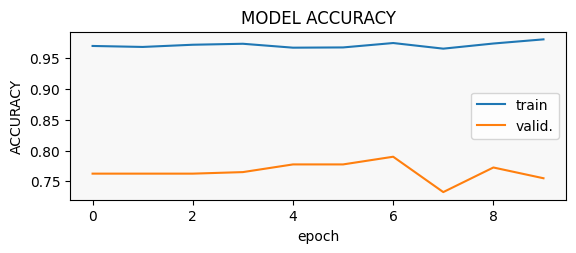

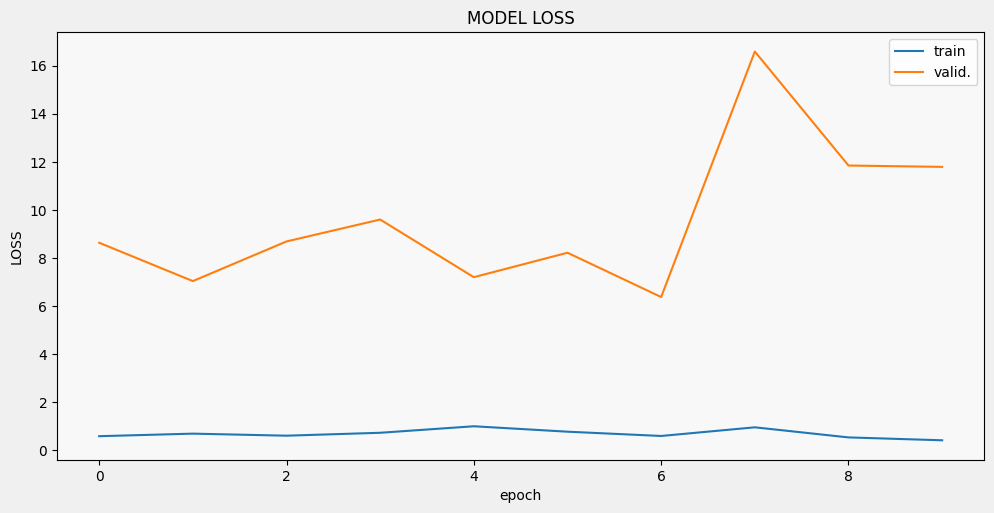

In [ ]:
display_training_curves(
    history2.history['accuracy'],
    history2.history['val_accuracy'],
    'ACCURACY',
    212,
)


display_training_curves(
    history2.history['loss'],
    history2.history['val_loss'],
    'LOSS',
    211,
)


<ipython-input-9-dcc572878ae4>:5: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(subplot)


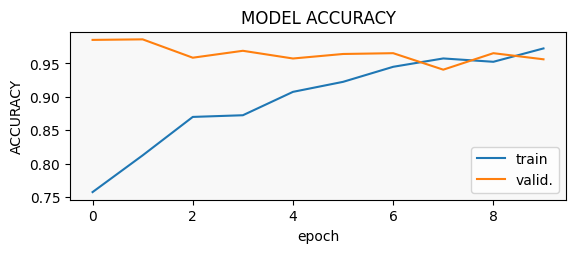

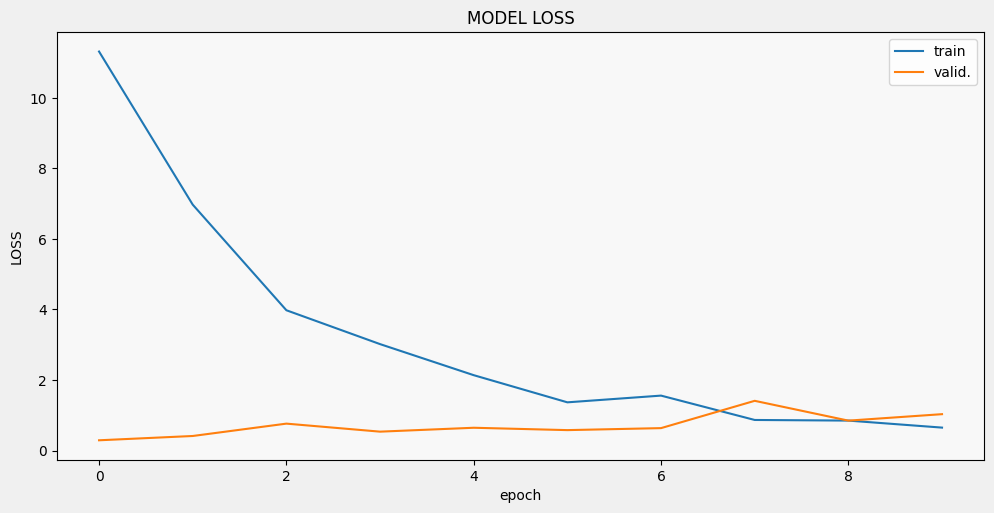

In [ ]:
display_training_curves(
    history3.history['accuracy'],
    history3.history['val_accuracy'],
    'ACCURACY',
    212,
)


display_training_curves(
    history3.history['loss'],
    history3.history['val_loss'],
    'LOSS',
    211,
)


<ipython-input-9-dcc572878ae4>:5: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(subplot)


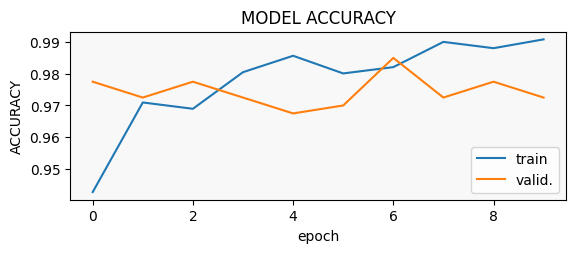

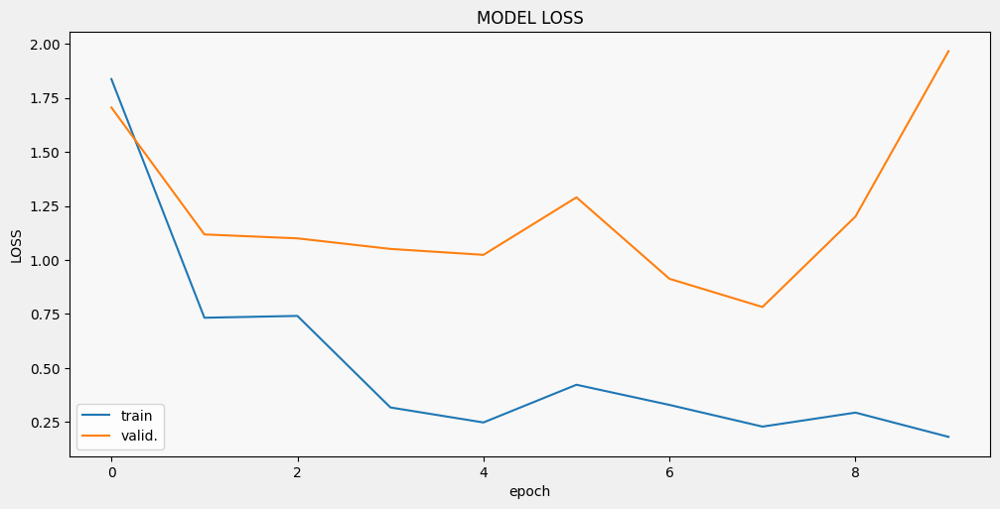

In [ ]:
display_training_curves(
    history4.history['accuracy'],
    history4.history['val_accuracy'],
    'ACCURACY',
    212,
)


display_training_curves(
    history4.history['loss'],
    history4.history['val_loss'],
    'LOSS',
    211,
)


# **accuracy**

In [ ]:
score = model.evaluate(test_generator,batch_size=32)
print("Accuracy: {:.2f}%".format(score[1] * 100))
print("Loss: ",score[0])

7/7 [==============================] - 6s 800ms/step - loss: 1.9668 - accuracy: 0.9725
Accuracy: 97.25%
Loss:  1.966751217842102


In [ ]:
score = model.evaluate(train_generator,batch_size=32)
print("Accuracy: {:.2f}%".format(score[1] * 100))
print("Loss: ",score[0])

40/40 [==============================] - 33s 815ms/step - loss: 0.1564 - accuracy: 0.9972
Accuracy: 99.72%
Loss:  0.1563827246427536


# **save model**


In [ ]:
!rm -R '/content/drive/MyDrive/model'
!mkdir '/content/drive/MyDrive/model'
model.save('/content/drive/MyDrive/model')

In [ ]:
!zip -r model.zip /content/model

  adding: content/model/ (stored 0%)
  adding: content/model/saved_model.pb (deflated 89%)
  adding: content/model/assets/ (stored 0%)
  adding: content/model/variables/ (stored 0%)
  adding: content/model/variables/variables.data-00000-of-00001 (deflated 20%)
  adding: content/model/variables/variables.index (deflated 69%)
  adding: content/model/keras_metadata.pb (deflated 95%)
  adding: content/model/fingerprint.pb (stored 0%)


# **reconstructing model and checking it for predicted accuracy**

In [ ]:
reconstructed_model = tf.keras.models.load_model('/content/drive/MyDrive/model')
# score = reconstructed_model.evaluate(test_generator,batch_size=32)
# print("Accuracy: {:.2f}%".format(score[1] * 100))
# print("Loss: ",score[0])

# score = reconstructed_model.evaluate(train_generator,batch_size=32)
# print("Accuracy: {:.2f}%".format(score[1] * 100))
# print("Loss: ",score[0])

# **test it with random images**

In [ ]:
class_names=train_generator.class_indices

labels={}
for key, value in class_names.items():
    labels[value]=key

In [ ]:
labels

{0: 'hyundai',
 1: 'lexus',
 2: 'mazda',
 3: 'mercedes',
 4: 'opel',
 5: 'skoda',
 6: 'toyota',
 7: 'volkswagen'}

# **predict for sample images**

In [ ]:
import cv2
import numpy as np
import tensorflow as tf
from google.colab.patches import cv2_imshow

def GetResultForImage(image_location):
  img = cv2.imread(image_location, cv2.IMREAD_UNCHANGED)

  print('Original Dimensions : ',img.shape)
  resized = cv2.resize(img,(IMAGE_SIZE,IMAGE_SIZE),3)
  result = np.expand_dims(resized, axis=0)
  result=reconstructed_model.predict(result)
  print(labels[np.argmax(result)])
  cv2_imshow(resized)

In [ ]:
import urllib.request
#hyundai
urllib.request.urlretrieve("https://images.unsplash.com/photo-1588036873025-7261a5647adf?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2220&q=80", "hyundai-1.jpg")
urllib.request.urlretrieve("https://images.unsplash.com/photo-1471977360223-d8cc63cec57c?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2340&q=80", "hyundai-2.jpg")

#lexus
urllib.request.urlretrieve("data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAASwAAACoCAMAAABt9SM9AAAAeFBMVEX///8AAAD29vaysrJ6enpHR0fGxsZ0dHQpKSn5+fmmpqZjY2NtbW3W1tbo6OhLS0uMjIw3Nzfw8PBfX1+dnZ28vLzi4uKSkpLPz8+srKy2trZQUFAiIiLk5OTc3NwTExOEhISPj48ZGRk+Pj4xMTFYWFgLCwsdHR0qW3nfAAAJyUlEQVR4nO2d22LiIBCG10NTE020qfFUtbGt9v3fcGs0BJjhnBqxfFe7FhV+YRhmgPz7FwgEAoFAIBAIBAKBQCAQCAQCN6Cf7dNVdCZNs7zr2twpi2I+fP3qAbZvw3mxj7uu3t2QJs8jqBLLabyM/nw/WyRHlU4Nn4uuq9sh6eykr1RFv+sqd0Q+f0dG23G4HESrfZbna0ys6OeNvemm67rfmHTM6/BUbvZMkRdErJ+XqzeWf8h+RZ+sBi/LFSizwDvW5vrPyR+xXykr1dMA7SaIVsufl4fkf5M/0Lv6E0aAuaDJU6jVsfpDXpIXZjesdicwdvulEBU7QK3e67/ljb2LblPpbug/0VKJmxohgzBr/pwSJ3Zyg0p3xIpuvLBX/WiKaMUqm5DXH9XQL6m2H2QFEa+Bt085mSUGv1jj7qBcq9FOVrCEWk1hKSJ9+TvV7RTKXJXSgpjBwsqRQf14hotyriTW6occ0Qo3TPnH9c9vv1HhDvlUtZyAGCyhWarLvrZd3U55JQ0/KRzvGdTqWVx6qi7iHY0CJ0WUZQW1+pKVr/vWvM3qdkrRtFyhFeZhSbtiXAd64FLcTyiTnSmKPkGtFEuarC73IHH6RgHVz7+EWkm91zN1t32MKbFZmqgMyx5q9aT+/DqM8QiufGOGEDecBTFYOoOrLttCZbvmmTRclW54hVqlOt8wuBYunevaNcQA99aKkkiKQtMh2F6Lq6aPu4cERkeKghnUStdm1zbed9e0cRtUUU0kK639LboD/c451O14URQcQq20DFbF/PqOpVtlu0a3YyFxGYOWkyHsVtmOIRqc5OViqJWqKzLU+2+8XvSQwaWY15DMl1FasHb9hy6V7RrSdPmsPodamfnjJFjhUtmOITl4aZgFS9UfDb+pfp/HyR7iZ8qN9QcUyzSGUDseKs/3jiEmS2p4Ea9BHqZHqH1fj40WibzLvEXEazCPqR+u7/y0r2zXkNZLyiBeg0Ugb63xTfcN0UG2yEM2lVps7SORa28DpsSxlqxwkViDMu6FQHwHbyMPJPJZCotgKVWbXWpErL267H2S1i0Q++9vUCurrBYRS3/1fWcQsYR79Aqo1bfVV/kv1k45DJGN8HZrYSKWdH/OPUMM0lhQIIFaiYoqIF3U3225dQtECS2olW2wkyzFrevaOT15EzZQK9s9C/Vyx87i3QVkrsP7C0zWK2KEYhxH8T1ANjyiQWXExzJeQF8hQR6Pd9MQs4uGaKDf8I4V04FskvA4rkzWO6iFh9tArHeHkk+wr2v3ED8KM1owjmVrcUgfNQ2w3hXEaGGBhAkQy7Zj1Pl7nwOllGONjUNELLtx2Pi23gZoKkgzkNDJAYrV630+GdPk0Tx2HM7IzkEgq2hHPJ4LzzRb2RAT37ZWRknse4TsZSvh35AtpE54f/ywcdMRq6W8/MII7zsW5U0hofV4K2u8Kd5GlBuaVBfmBBlcGKLC931/FQPSHCzzUrTWuW7esF+B+EFb9M8rJH1vgbfxZJbGfRCl5bNovSyHDpSJ3747RXPUy+N9Gzej2axWdl0VDxj+St+K51eSFj/0Dhgr7ZY55Iy0vxscBDTxmK+WUnvNTmh/c4UiKAfBNi2Bf97oYSZCCmpL8ti5fc12wcc6eU+gD4u7meSsWSV5nPuS06dud/i2H4tZc4TR300zGtCnAz7szunS1wU+xNpZTM7sXpuZLuj6CRUC2z5yt7oQMWGGr7m+j5SvmSM+Xqe9tNmwN5S+l4XaUcqjkg2rPpjTLqHg7t7snSbzSDQkF8WczzB+/I1eVbNHg1hP43KZrIsL62Q5HPOqnhl7n5gwp0Ay0mqm60d02HWIym8jpSYbz4+MO5IXJTbUAB+T9QNkb9pgV8yfp6L7zr9eZ4P0r449Mfl+VWySZHkhSTZRugsqBQKBQCAQCAQCgcANiI6vhKP9PXDZqhgMEgt0PjyZYSjDpdGAAt0j30+ZMkLqy5MG9ArfLre0mmlFWXBOyshLLvh0ZS6aiS7CpkVD5HFlOPXvwpy9tRBr57zLUZFURg4HX1AePnmmS/N7nZALzsTU/d9NrAy5ttaYqSQOE4u/wEUs9CF3Yurf00ks4zMSnyn6sjAFwZzvGe2ZU9X2YokGtpAWxIrNTdXXvxi5UUW0fTJjxBlwD7iwFgv/wWS4i4Vc8KvkfPkfcvUFvsXtQBeormhpRSyL02jOYiG3t6upbkrcoQcF+MOuzI1tx4uWbYgFHpPxOlExrutmKxbQamhwkyM6gzLHWPuMYa9tWgticePh3Wjrk6VY4FIGs0QV9tgm2uViJvamVi2IxfpWhifQLcXi/TnTTbC4nb/ahpQepyfK93YXi30QmeklcHZi8Q+gtdhcjdr5s8sVM40s6fc4i8UNQtNEm5VY/IRitbMTt/MrpkJbySOAbcRif2TjfUtWYvEtNP3SK8qVEr+wdxXLsWNZiQXWVYXW2h1OPKidJ7yALVuuYrErDo3n1HDYiCVtoqTx8JP6qJ2/gIxtV7HYaWk0VlNu6KnLQix5fxCD/pKonT8XxuZXR7F2PRuOzUZfC7GQ54BqgXf7HbpHCw9DOooljPYoIO6yhVi2oT6RjUDtPOpZO4qFPDxRj21sLVZ+ITYdjkKDGmEhS6wujmLx3qE+39Zi/UPeqYNYLNTjGkFP11Es5ImAukzcxDKKy1YIHs7QF17uAG7dchRLMvUqSYFYBvdXwVnsrchjOZof1MD/eI5ixUURrQDRKt0DCv5BulV6hMnu6F/UDx+eancf0+ILfBDNlnUgmBYoIwbShIWSZ7Ym1SqFtdK6W6fBw1M/7DZds14IZueZWZER60P14W5i8YGVc2dgn+OifKrnFWBmrLRif6hRis7t9FBkv1b1nY5iHZBfjX1JL4YHnAaLJynwhr0KAWC5hG0zK07gOyQ4isWlrqomcv64llq8obG5jZU17OO6m2C+EPkpuPorupajWNwzuarQNh8g1tjvAKy7+R6JPaP3N3XOEnPf6lmai6ON5PFZN7H4elz6NzAUz5tVKmMPssSzyBC2O7PxhZyftXvEQQXPnTnIsiTMMspQrD6fP67vyJbP3r/OGPQPLNF9GYpIMv9lKuCNWRe8j0yAi3vyg7Z7954Z75h/htn5alZEnsF2IxqPGnm+4I0QRe+Rw4jVrGi+yGoH2t3rqA5vYguNJdnPQ9E6zOIE+3yXfjuXyZkhvdkB2+pyHoq2cVoXgEcXr288GD9ViVnEzldDcXPjik7Rs+5xNJ847Hg0QyPXuEceE1n1xn4xO2rvcXTjbSm/qSPu34AWTl32swVwAfeLXaYgV9UsHAgNBAKBQCAQCAQCgUAgEAgE/hj/AdyQhnaNg4ZaAAAAAElFTkSuQmCC", "lexus-1.jpg")
urllib.request.urlretrieve("https://thumbs.dreamstime.com/z/new-hope-minnesota-october-close-up-lexus-logo-emblem-car-257994350.jpg", "lexus-2.jpg")

#mazda
urllib.request.urlretrieve("https://www.shutterstock.com/image-photo/bangkokthailand-may-222014-logo-brand-260nw-204080434.jpg","mazda-1.jpg")
urllib.request.urlretrieve("https://www.schoolphotoproject.com/_picture-of-cars-motorbikes/car-mazda-logo-photo-l.jpg","mazda-2.jpg")


#mercedes
urllib.request.urlretrieve("https://images.newindianexpress.com/uploads/user/imagelibrary/2021/12/2/w900X450/Mercedes_Benz_AP.jpg?w=400&dpr=2.6","mercedes-1.jpg")
urllib.request.urlretrieve("https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQ854tdVSiZLeBxVSjW-zdtGnHAA67yu2N06w&usqp=CAU","mercedes-2.jpg")

#opel
urllib.request.urlretrieve("https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQESUxbt7oUoBmKslA5YNh3b0NcXUojMM3Aeg&usqp=CAU","opel-1.jpg")
urllib.request.urlretrieve("https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRgyyB9T1otFMlgiMojMr3GE03fFoEsU6reQA&usqp=CAU","opel-2.jpg")


#skoda
urllib.request.urlretrieve("https://thumbs.dreamstime.com/b/bordeaux-aquitaine-france-skoda-logo-brand-car-dealership-text-sign-vehicle-store-showroom-shop-czech-bordeaux-aquitaine-france-219259318.jpg","skoda-1.jpg")
urllib.request.urlretrieve("https://media.gettyimages.com/id/1230550013/photo/a-skoda-logo-seen-on-a-parked-car-in-dublin-city-center-on-tuesday-january-11-in-dublin.jpg?s=612x612&w=gi&k=20&c=b8xHL2cUjvyQC1jGIVLqgglYVZGB7RGWqd5QV2VD5cw=","skoda-2.jpg")


#toyota
urllib.request.urlretrieve("https://us.123rf.com/450wm/engdao/engdao1904/engdao190400491/engdao190400491.jpg?ver=6","toyota-1.jpg")
urllib.request.urlretrieve("https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQLednVkQl--Dx9jOqUFk1t5EXfTkzyiiWPOw&usqp=CAU","toyota-2.jpg")

#volkswagen
urllib.request.urlretrieve("https://www.thedrive.com/content/2020/04/vw-logo-atlas.jpg?quality=85&crop=16%3A9&auto=webp&optimize=high&quality=70&width=1440","volkswagen-1.jpg")
urllib.request.urlretrieve("https://m.media-amazon.com/images/I/51SsqpaeYOL.jpg","volkswagen-2.jpg")


('volkswagen-2.jpg', <http.client.HTTPMessage at 0x7b5d7c6ec940>)

Original Dimensions :  (1591, 2220, 3)
1/1 [==============================] - 0s 19ms/step
hyundai


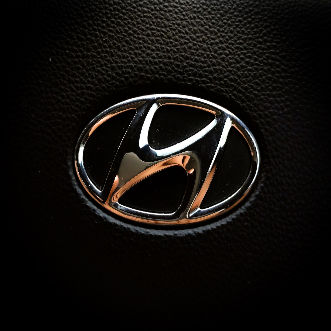

Original Dimensions :  (1560, 2340, 3)
1/1 [==============================] - 0s 22ms/step
skoda


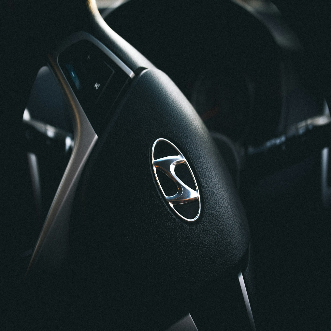

Original Dimensions :  (168, 300, 3)
1/1 [==============================] - 0s 33ms/step
lexus


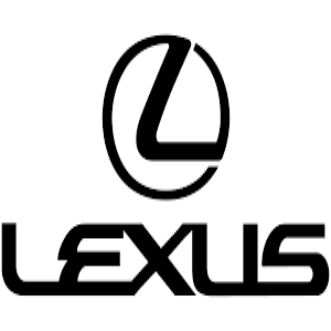

Original Dimensions :  (1157, 1600, 3)
1/1 [==============================] - 0s 19ms/step
lexus


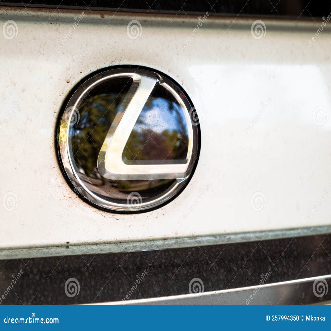

Original Dimensions :  (280, 390, 3)
1/1 [==============================] - 0s 20ms/step
mazda


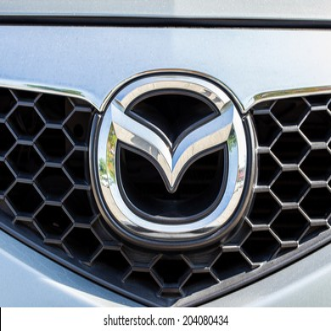

Original Dimensions :  (1704, 2272, 3)
1/1 [==============================] - 0s 25ms/step
mazda


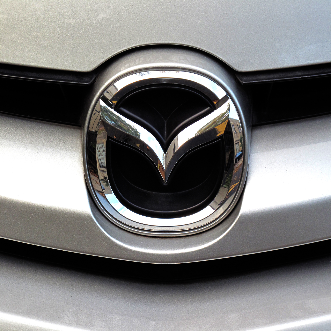

Original Dimensions :  (450, 900, 3)
1/1 [==============================] - 0s 24ms/step
mercedes


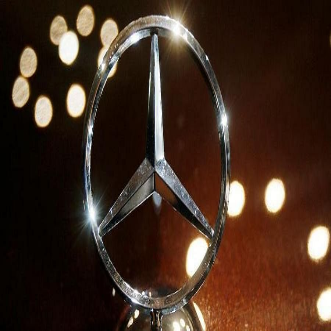

Original Dimensions :  (168, 300, 3)
1/1 [==============================] - 0s 21ms/step
mercedes


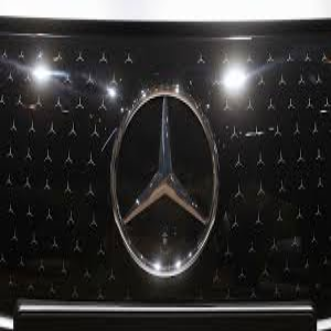

Original Dimensions :  (192, 263, 3)
1/1 [==============================] - 0s 20ms/step
opel


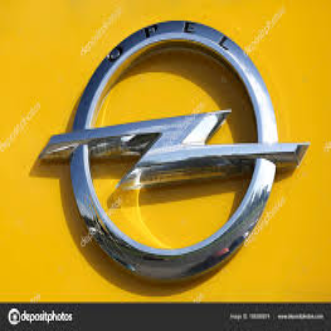

Original Dimensions :  (169, 299, 3)
1/1 [==============================] - 0s 28ms/step
opel


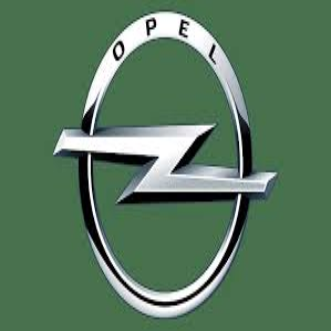

Original Dimensions :  (534, 800, 3)
1/1 [==============================] - 0s 32ms/step
skoda


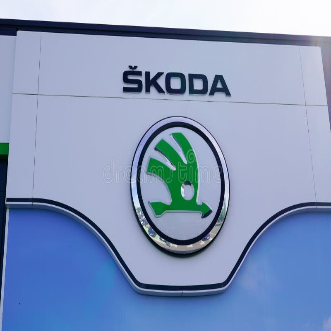

Original Dimensions :  (408, 612, 3)
1/1 [==============================] - 0s 24ms/step
skoda


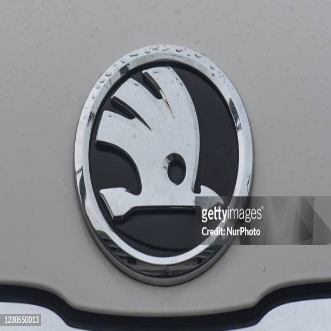

Original Dimensions :  (300, 450, 3)
1/1 [==============================] - 0s 27ms/step
toyota


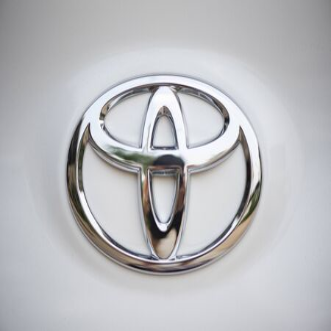

Original Dimensions :  (168, 299, 3)
1/1 [==============================] - 0s 26ms/step
toyota


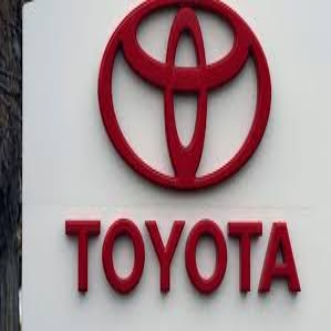

Original Dimensions :  (810, 1440, 3)
1/1 [==============================] - 0s 31ms/step
volkswagen


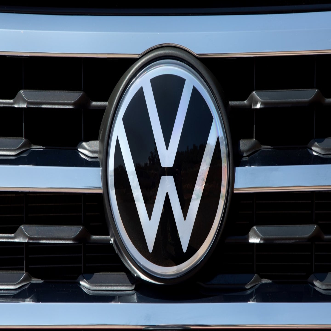

Original Dimensions :  (464, 500, 3)
1/1 [==============================] - 0s 37ms/step
volkswagen


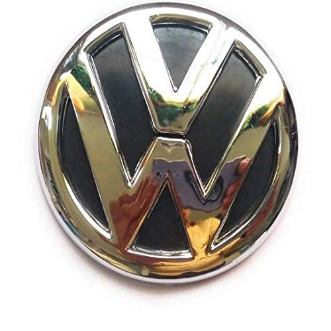

In [ ]:
GetResultForImage("hyundai-1.jpg")
GetResultForImage("hyundai-2.jpg")

GetResultForImage("lexus-1.jpg")
GetResultForImage("lexus-2.jpg")

GetResultForImage("mazda-1.jpg")
GetResultForImage("mazda-2.jpg")

GetResultForImage("mercedes-1.jpg")
GetResultForImage("mercedes-2.jpg")


GetResultForImage("opel-1.jpg")
GetResultForImage("opel-2.jpg")

GetResultForImage("skoda-1.jpg")
GetResultForImage("skoda-2.jpg")

GetResultForImage("toyota-1.jpg")
GetResultForImage("toyota-2.jpg")


GetResultForImage("volkswagen-1.jpg")
GetResultForImage("volkswagen-2.jpg")

In [ ]:
import cv2
import numpy as np
import tensorflow as tf
from google.colab.patches import cv2_imshow


def cut_to_four_parts(img):
  w,h,c = img.shape
  print('Dim',w,h, img.shape)
  img1 = img[0:int(w/2),0:int(h/2)]
  img2 = img[int(w/2):h,0:int(h/2)]
  img3 = img[0:int(w/2),h // 2:h]
  img4 = img[int(w/2):h,h // 2:h]
  imgs = [img1, img2, img3, img4]
  resized_imgs = [cv2.resize(img_i,(IMAGE_SIZE,IMAGE_SIZE),3) for img_i in imgs]
  result_imgs = [np.expand_dims(img_i, axis=0) for img_i in resized_imgs]
  for img in imgs:
    cv2_imshow(img)
    print("---------------------------------------")
  return result_imgs


def predict_full_img(img, n):
  resized_img = cv2.resize(img, (IMAGE_SIZE,IMAGE_SIZE),3)
  result_img = np.expand_dims(resized_img, axis=0)
  predict(result_img, n)


def predict(result_img, n):
  result = reconstructed_model.predict(result_img)[0]
  result_label = labels[np.argmax(result)]
  if n > len(labels):
    print("ERROR: N IS TOO LARGE")
  else:
    top_n = np.argsort(result)[-n:][::-1]
    # print(result, top_n)
    for ind in top_n:
      print(labels[ind], round(result[ind] * 100, 3))
      # cv2_imshow(result_img)
    # print(result_label, top_n)
    return result_label


# def GetResultForImage(image_location):
#   img = cv2.imread(image_location, cv2.IMREAD_UNCHANGED)
# im = cv2.imread('honda_civic.jpg')
# img = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)   # BGR -> RGB


# w,h,c = img.shape
# print('Dim',w,h)


# img1 = img[0:int(w/2),0:int(h/2)]
# img2 = img[int(w/2):w,0:int(h/2)]
# img3 = img[0:int(w/2),w:h]
# img4 = img[int(w/2):w,w:h]


# cv2.imshow("demo",img1)
# cv2.waitKey(0)
# cv2.destroyAllWindows()


import cv2
import numpy as np
import tensorflow as tf
from google.colab.patches import cv2_imshow

def GetResultForImage(img, n):
  # img = cv2.imread(image_location, cv2.IMREAD_UNCHANGED)
  resized_imgs = cut_to_four_parts(img)
  # print('Original Dimensions : ',img1)
  # results = [reconstructed_model.predict(img) for img in resized_imgs]
  # results_labels = [labels[np.argmax(result)] for result in results]
  # print(labels[np.argmax(result)])
  predict_full_img(img, n)
  cv2_imshow(img)
  for img in resized_imgs:
    predict(img, n)
    # cv2_imshow(img)
  # for i, img in enumerate(results):
  #   print(results_labels[i])
  #   cv2_imshow(results[i])


  # cv2_imshow(resized)

Dim 468 590 (468, 590, 3)


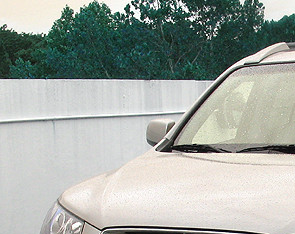

---------------------------------------


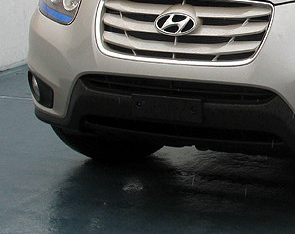

---------------------------------------


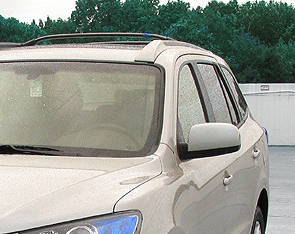

---------------------------------------


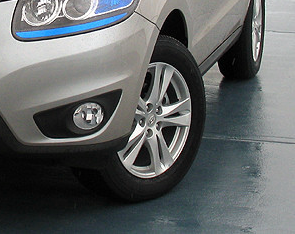

---------------------------------------
1/1 [==============================] - 0s 19ms/step
mercedes 100.0
opel 0.0
volkswagen 0.0


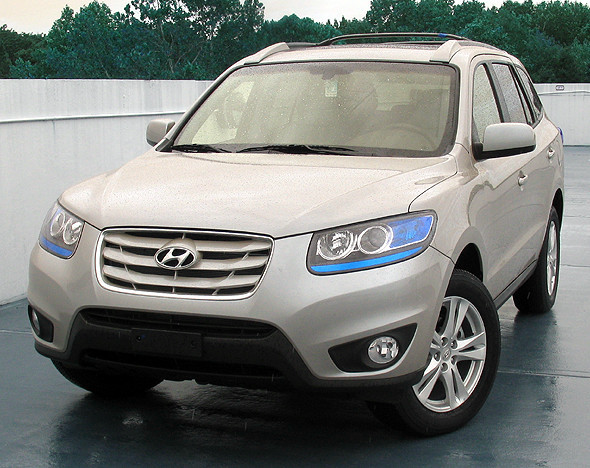

1/1 [==============================] - 0s 26ms/step
opel 99.997
toyota 0.002
mazda 0.001
1/1 [==============================] - 0s 18ms/step
lexus 100.0
volkswagen 0.0
toyota 0.0
1/1 [==============================] - 0s 19ms/step
lexus 100.0
opel 0.0
skoda 0.0
1/1 [==============================] - 0s 20ms/step
toyota 100.0
volkswagen 0.0
mercedes 0.0


In [ ]:
im1 = cv2.imread('/content/drive/MyDrive/00761.jpg')
img1 = cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)
GetResultForImage(img1, 3)
# predict_full_img(img1, 3)

Dim 850 1280 (850, 1280, 3)


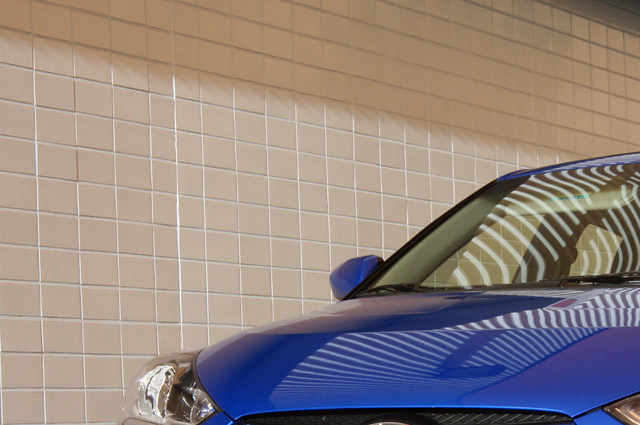

---------------------------------------


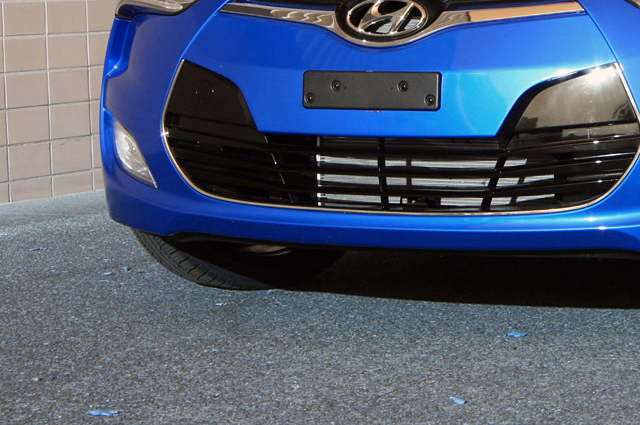

---------------------------------------


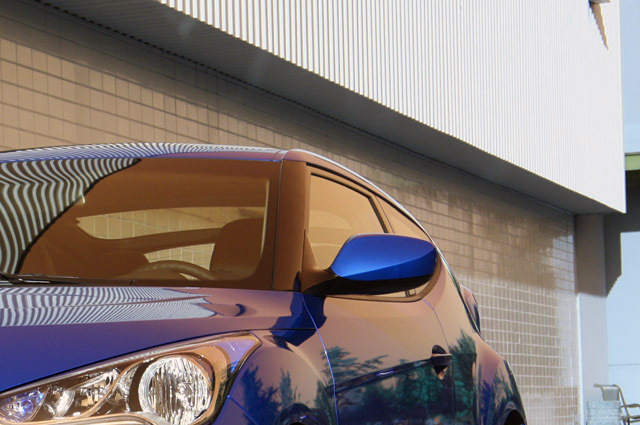

---------------------------------------


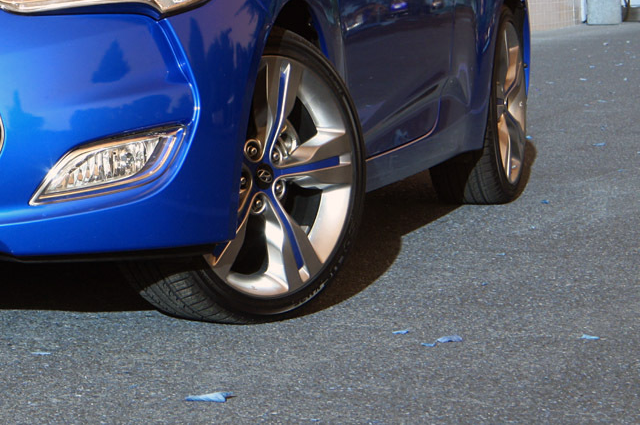

---------------------------------------
1/1 [==============================] - 0s 27ms/step
toyota 99.997
mazda 0.003
mercedes 0.0


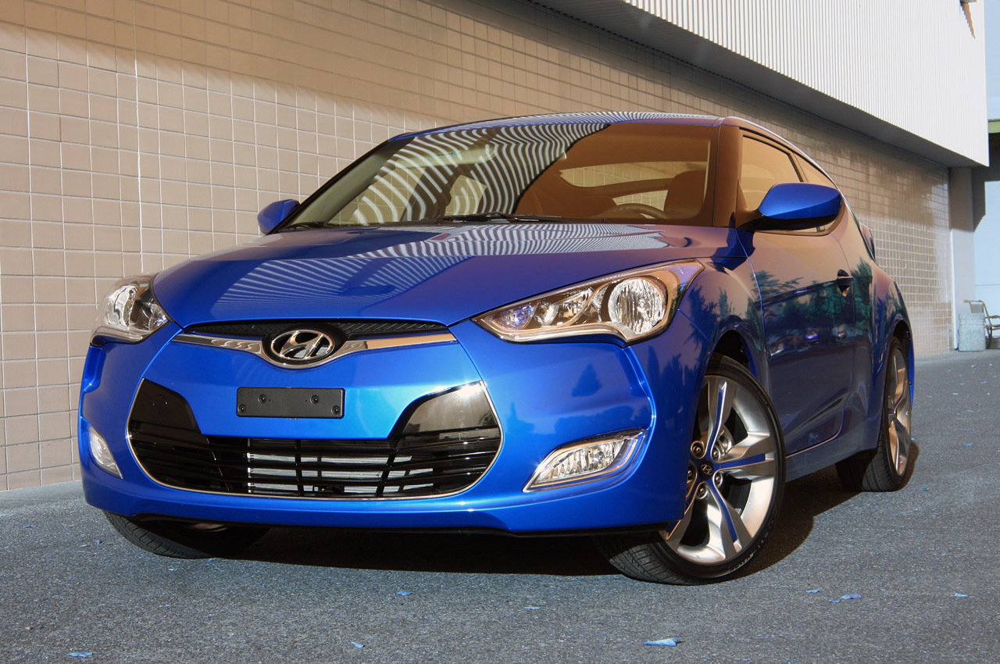

1/1 [==============================] - 0s 31ms/step
mercedes 99.861
mazda 0.133
volkswagen 0.006
1/1 [==============================] - 0s 24ms/step
lexus 100.0
opel 0.0
volkswagen 0.0
1/1 [==============================] - 0s 26ms/step
mercedes 100.0
toyota 0.0
skoda 0.0
1/1 [==============================] - 0s 31ms/step
toyota 99.997
lexus 0.003
volkswagen 0.0


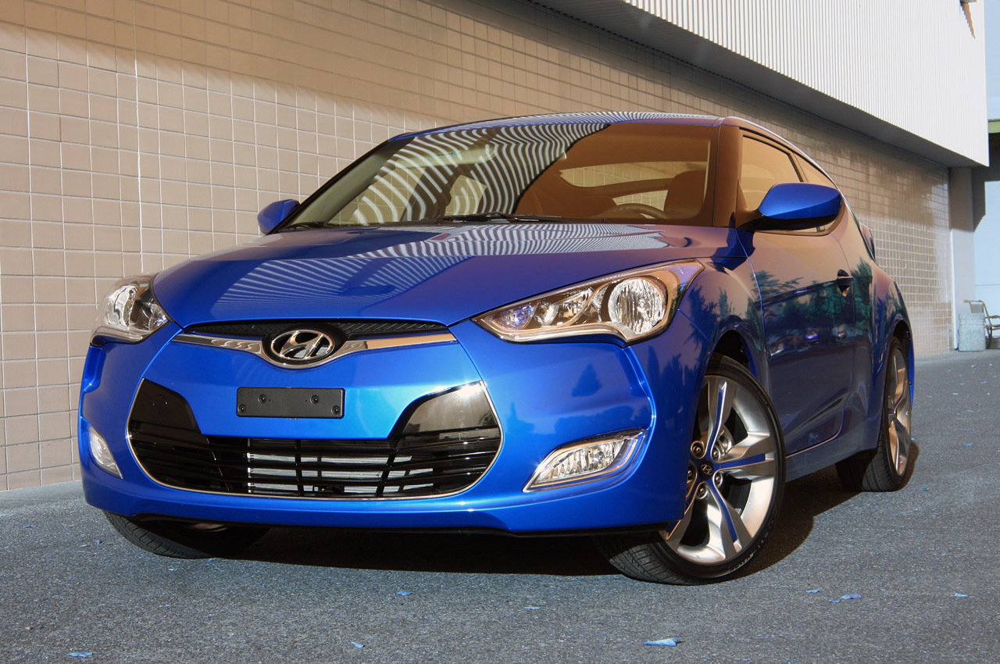

In [ ]:
im2 = cv2.imread('/content/drive/MyDrive/01632.jpg')
img2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
GetResultForImage(img2, 3)
# predict_full_img(img1, 3)
cv2_imshow(img2)

Dim 422 749 (422, 749, 3)


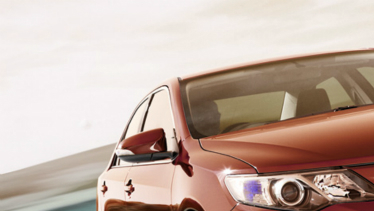

---------------------------------------


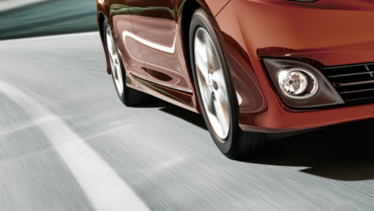

---------------------------------------


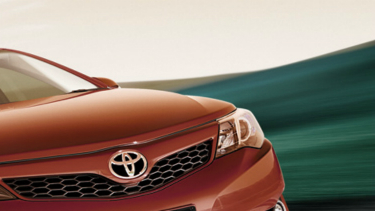

---------------------------------------


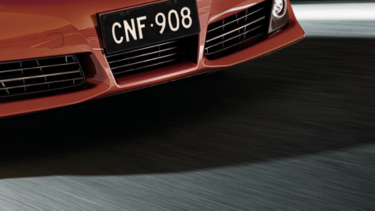

---------------------------------------
1/1 [==============================] - 0s 32ms/step
lexus 100.0
opel 0.0
volkswagen 0.0


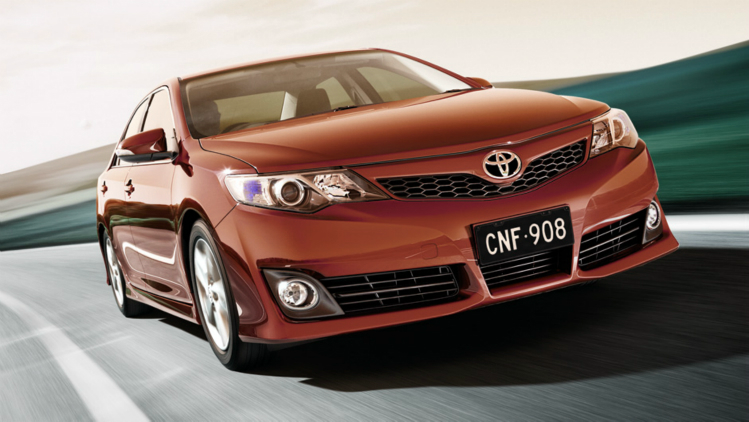

1/1 [==============================] - 0s 28ms/step
lexus 100.0
volkswagen 0.0
opel 0.0
1/1 [==============================] - 0s 21ms/step
toyota 78.614
mazda 20.63
skoda 0.753
1/1 [==============================] - 0s 17ms/step
toyota 87.742
mercedes 12.251
volkswagen 0.005
1/1 [==============================] - 0s 22ms/step
lexus 100.0
opel 0.0
mazda 0.0


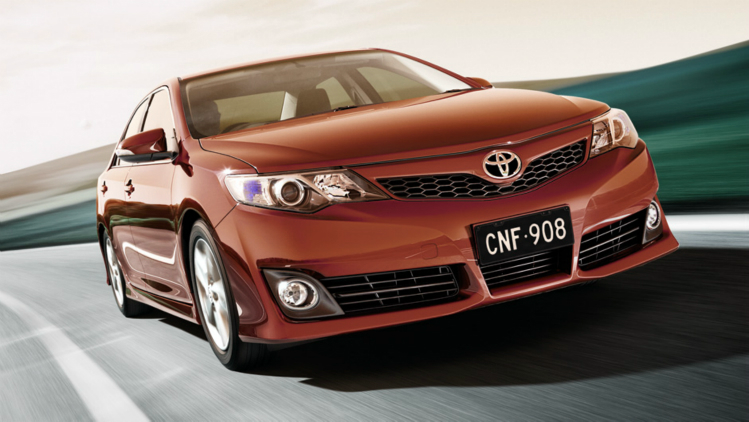

In [ ]:
im3 = cv2.imread('/content/drive/MyDrive/03835.jpg')
img3 = cv2.cvtColor(im3, cv2.COLOR_BGR2RGB)
GetResultForImage(img3, 3)
# predict_full_img(img1, 3)
cv2_imshow(img3)

Dim 599 658 (599, 658, 3)


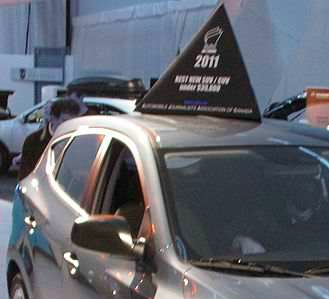

---------------------------------------


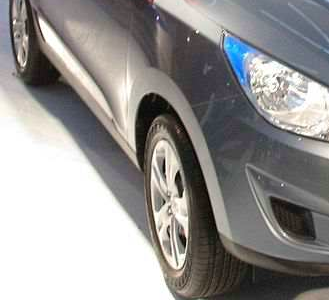

---------------------------------------


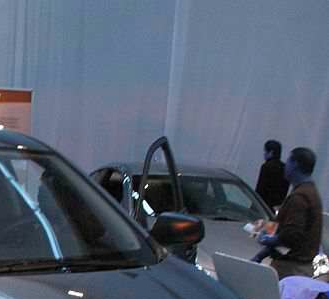

---------------------------------------


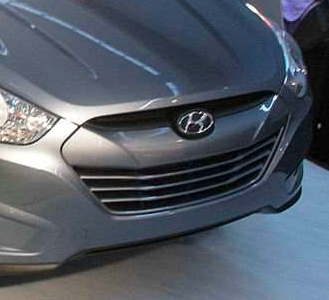

---------------------------------------
1/1 [==============================] - 0s 23ms/step
lexus 100.0
opel 0.0
mercedes 0.0


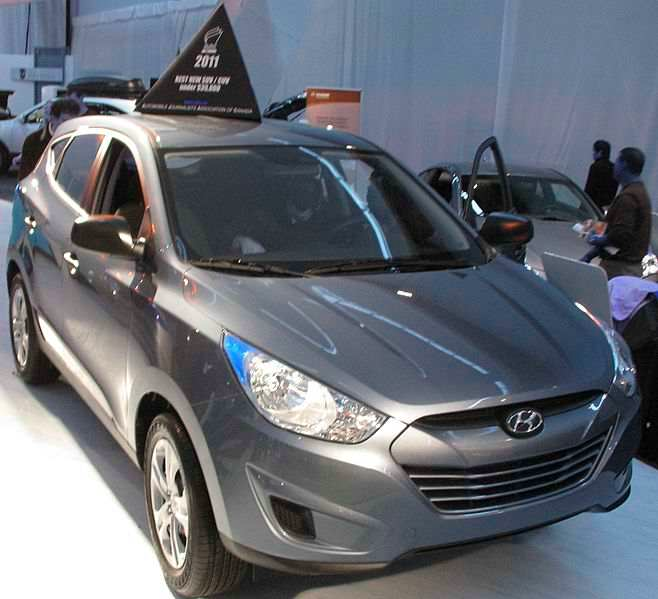

1/1 [==============================] - 0s 31ms/step
lexus 99.99
opel 0.01
skoda 0.0
1/1 [==============================] - 0s 19ms/step
toyota 99.967
skoda 0.032
volkswagen 0.0
1/1 [==============================] - 0s 20ms/step
mercedes 94.803
toyota 5.196
lexus 0.001
1/1 [==============================] - 0s 18ms/step
lexus 89.583
opel 10.416
hyundai 0.001


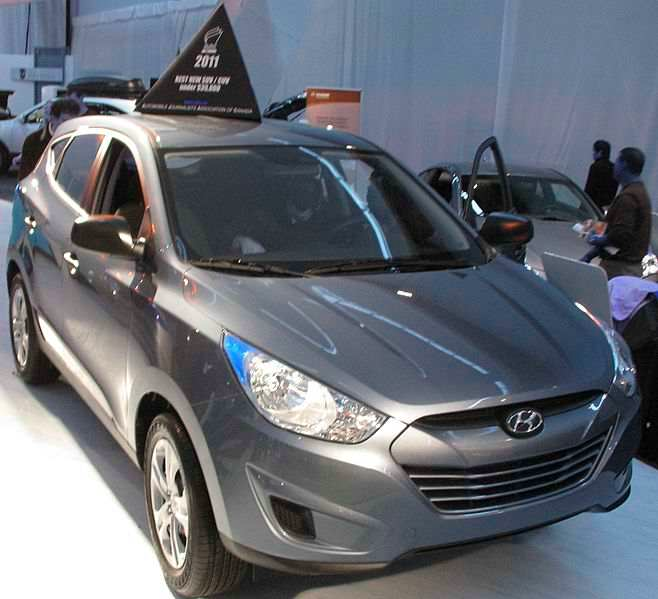

In [ ]:
im4 = cv2.imread('/content/drive/MyDrive/04404.jpg')
img4 = cv2.cvtColor(im4, cv2.COLOR_BGR2RGB)
GetResultForImage(img4, 3)
# predict_full_img(img1, 3)
cv2_imshow(img4)

Dim 400 599 (400, 599, 3)


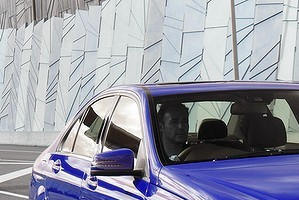

---------------------------------------


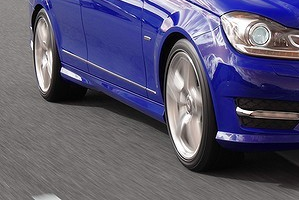

---------------------------------------


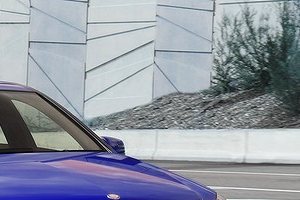

---------------------------------------


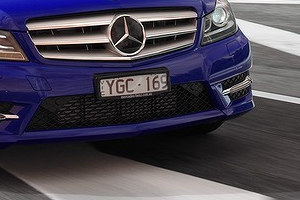

---------------------------------------
1/1 [==============================] - 0s 27ms/step
opel 100.0
lexus 0.0
mercedes 0.0


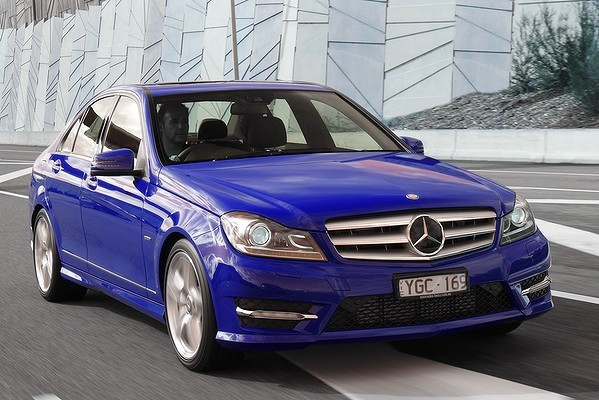

1/1 [==============================] - 0s 38ms/step
lexus 93.84
mercedes 5.877
toyota 0.268
1/1 [==============================] - 0s 27ms/step
skoda 99.619
toyota 0.381
lexus 0.0
1/1 [==============================] - 0s 36ms/step
skoda 84.739
toyota 14.73
opel 0.295
1/1 [==============================] - 0s 27ms/step
lexus 99.861
opel 0.139
toyota 0.0


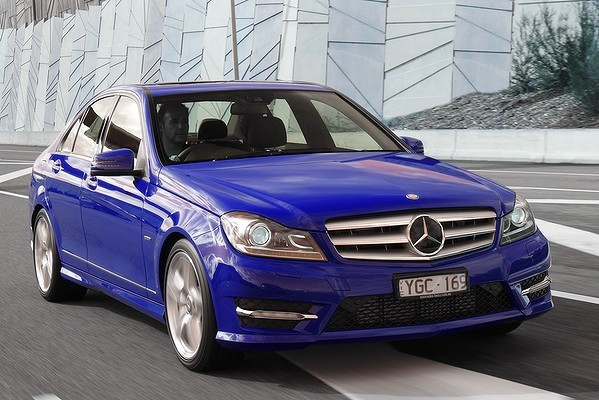

In [ ]:
im5 = cv2.imread('/content/drive/MyDrive/07024.jpg')
img5 = cv2.cvtColor(im5, cv2.COLOR_BGR2RGB)
GetResultForImage(img5, 3)
# predict_full_img(img1, 3)
cv2_imshow(img5)

Dim 420 650 (420, 650, 3)


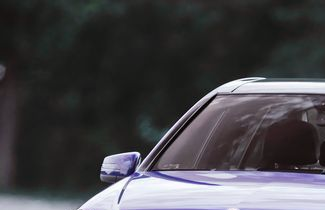

---------------------------------------


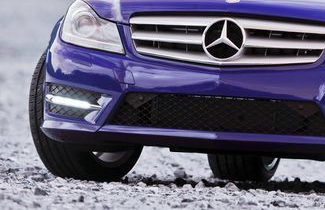

---------------------------------------


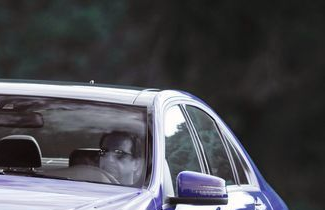

---------------------------------------


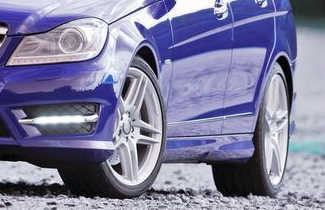

---------------------------------------
1/1 [==============================] - 0s 25ms/step
mercedes 100.0
lexus 0.0
opel 0.0


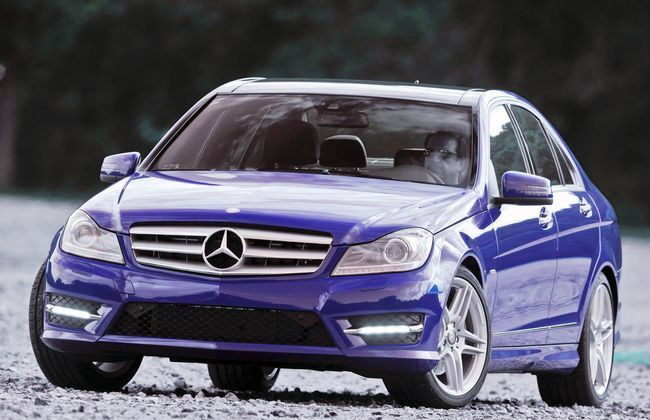

1/1 [==============================] - 0s 35ms/step
skoda 98.534
lexus 0.781
opel 0.447
1/1 [==============================] - 0s 18ms/step
mercedes 97.574
lexus 2.34
toyota 0.074
1/1 [==============================] - 0s 20ms/step
skoda 99.985
opel 0.014
toyota 0.001
1/1 [==============================] - 0s 25ms/step
mercedes 99.996
opel 0.004
volkswagen 0.0


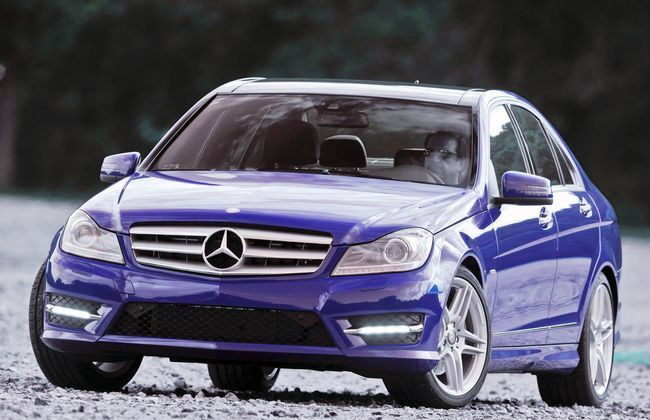

In [ ]:
im6 = cv2.imread('/content/drive/MyDrive/07513.jpg')
img6 = cv2.cvtColor(im6, cv2.COLOR_BGR2RGB)
GetResultForImage(img6, 3)
# predict_full_img(img1, 3)
cv2_imshow(img6)

Dim 480 640 (480, 640, 3)


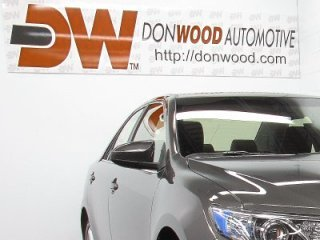

---------------------------------------


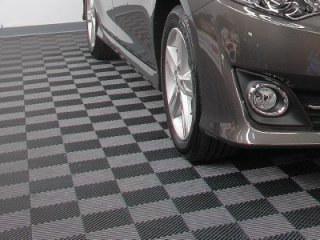

---------------------------------------


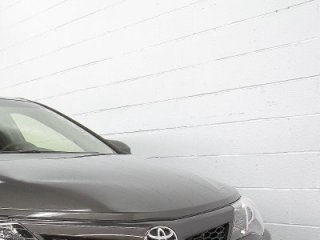

---------------------------------------


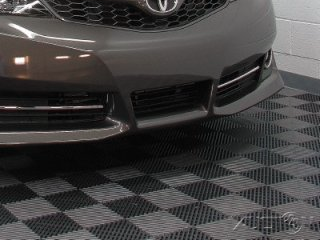

---------------------------------------
1/1 [==============================] - 0s 19ms/step
lexus 100.0
opel 0.0
volkswagen 0.0


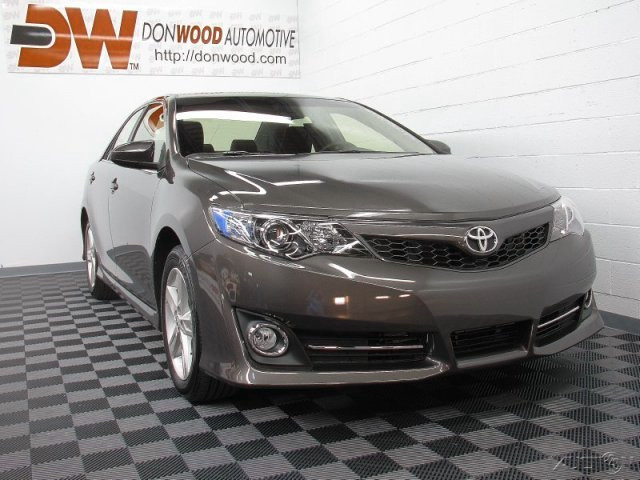

1/1 [==============================] - 0s 25ms/step
lexus 73.478
opel 26.41
toyota 0.096
1/1 [==============================] - 0s 19ms/step
toyota 99.025
volkswagen 0.699
mazda 0.101
1/1 [==============================] - 0s 18ms/step
mercedes 97.59
toyota 2.269
skoda 0.132
1/1 [==============================] - 0s 27ms/step
lexus 97.257
opel 2.664
hyundai 0.073


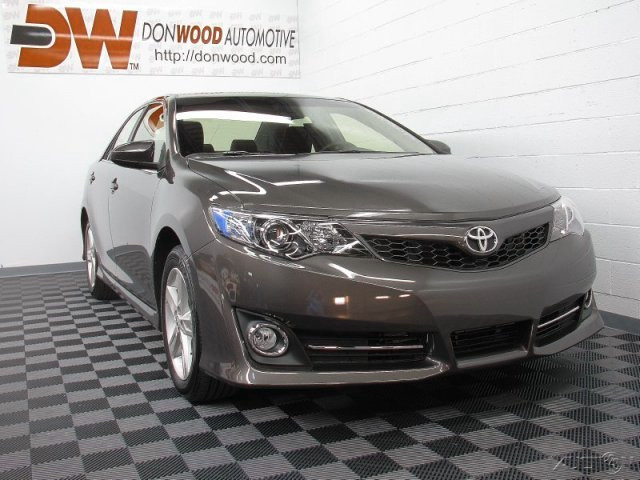

In [ ]:
im7 = cv2.imread('/content/drive/MyDrive/07987.jpg')
img7 = cv2.cvtColor(im7, cv2.COLOR_BGR2RGB)
GetResultForImage(img7, 3)
# predict_full_img(img1, 3)
cv2_imshow(img7)

Dim 720 1280
1/1 [==============================] - 0s 19ms/step
skoda


lexus


opel


lexus


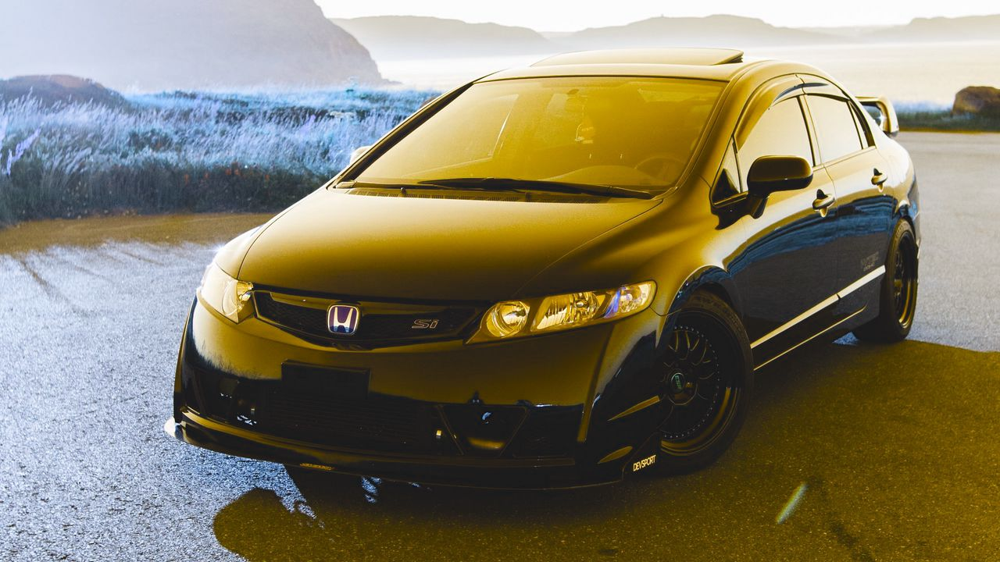

Dim 468 590
1/1 [==============================] - 0s 20ms/step
opel


lexus


lexus


toyota


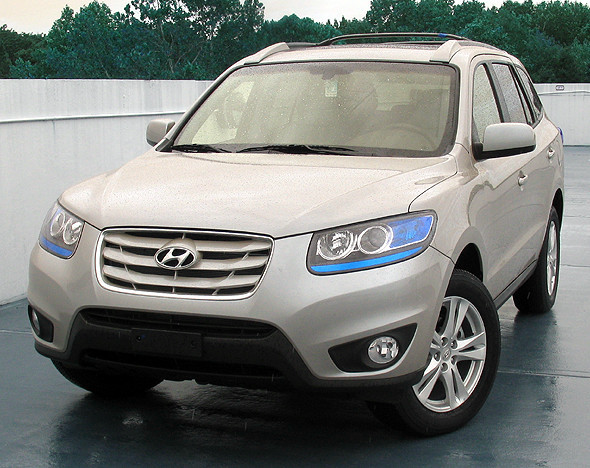

Dim 850 1280
1/1 [==============================] - 0s 19ms/step
mercedes


lexus


opel


opel


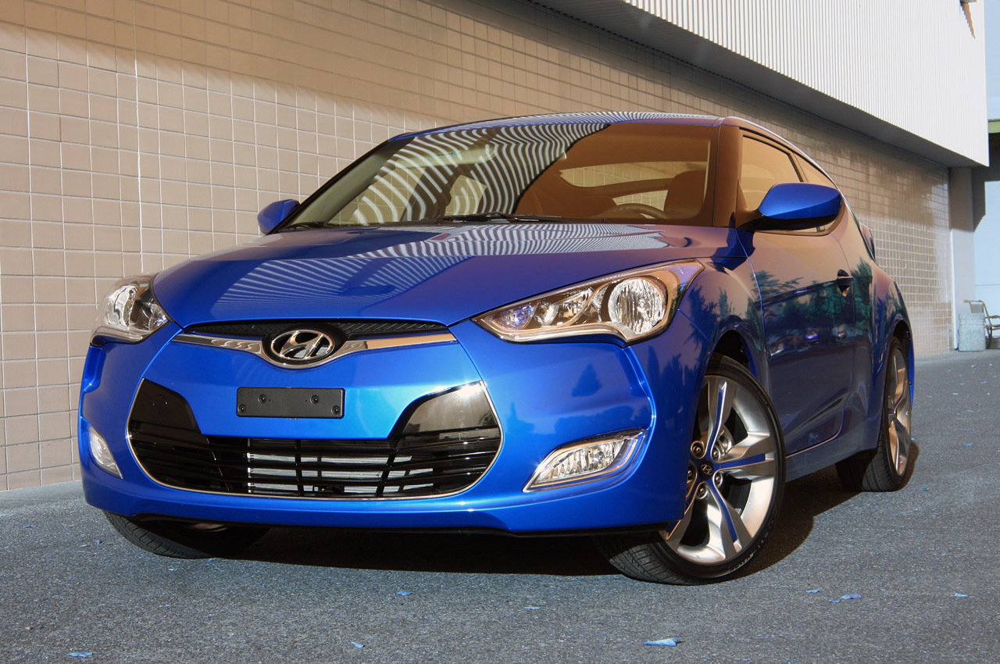

Dim 422 749
1/1 [==============================] - 0s 39ms/step
lexus


toyota


toyota


lexus


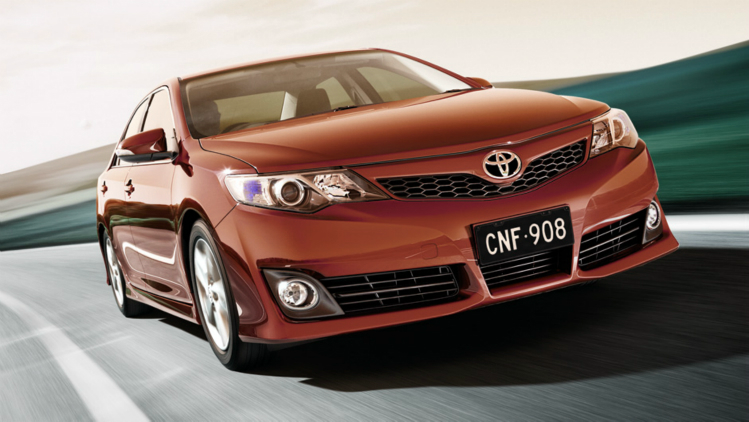

Dim 599 658
1/1 [==============================] - 0s 26ms/step
lexus


toyota


skoda


opel


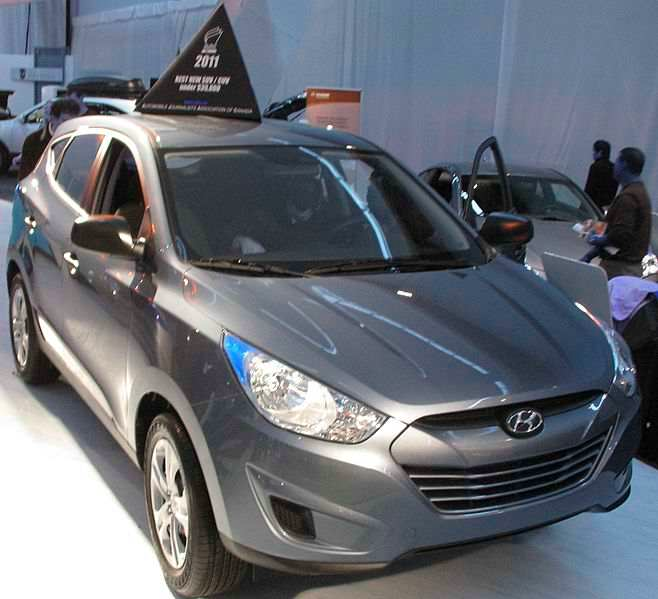

Dim 400 599
1/1 [==============================] - 0s 38ms/step
lexus


skoda


opel


lexus


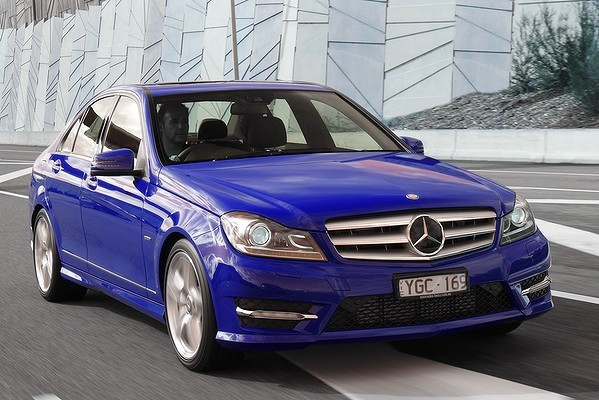

Dim 420 650
1/1 [==============================] - 0s 26ms/step
skoda


mercedes


skoda


opel


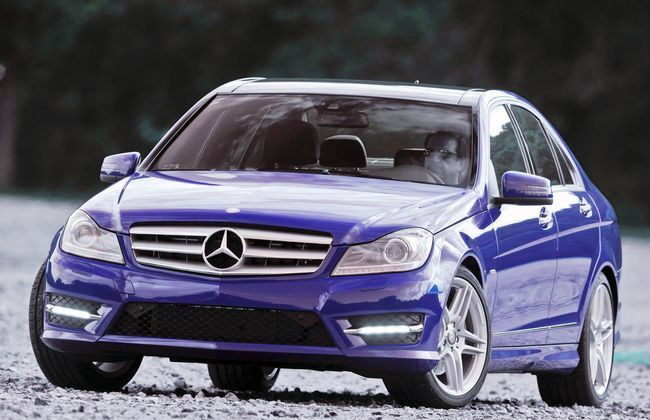

Dim 480 640
1/1 [==============================] - 0s 26ms/step
lexus


toyota


mercedes


lexus


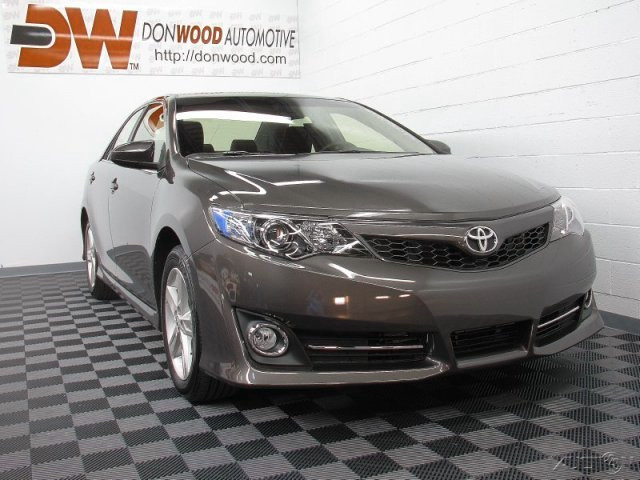

In [ ]:
import cv2

im = cv2.imread('/content/drive/MyDrive/honda_civic.jpg')
im1 = cv2.imread('/content/drive/MyDrive/00761.jpg')
im2 = cv2.imread('/content/drive/MyDrive/01632.jpg')
im3 = cv2.imread('/content/drive/MyDrive/03835.jpg')
im4 = cv2.imread('/content/drive/MyDrive/04404.jpg')
im5 = cv2.imread('/content/drive/MyDrive/07024.jpg')
im6 = cv2.imread('/content/drive/MyDrive/07513.jpg')
im7 = cv2.imread('/content/drive/MyDrive/07987.jpg')

img = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)   # BGR -> RGB
img1 = cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
img3 = cv2.cvtColor(im3, cv2.COLOR_BGR2RGB)
img4 = cv2.cvtColor(im4, cv2.COLOR_BGR2RGB)
img5 = cv2.cvtColor(im5, cv2.COLOR_BGR2RGB)
img6 = cv2.cvtColor(im6, cv2.COLOR_BGR2RGB)
img7 = cv2.cvtColor(im7, cv2.COLOR_BGR2RGB)


GetResultForImage(img)
cv2_imshow(img)
GetResultForImage(img1)
cv2_imshow(img1)
GetResultForImage(img2)
cv2_imshow(img2)
GetResultForImage(img3)
cv2_imshow(img3)
GetResultForImage(img4)
cv2_imshow(img4)
GetResultForImage(img5)
cv2_imshow(img5)
GetResultForImage(img6)
cv2_imshow(img6)
GetResultForImage(img7)
cv2_imshow(img7)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive
